In [ ]:
!pip install --extra-index-url https://pypi.anaconda.org/scipy-wheels-nightly/simple imagecodecs

Looking in indexes: https://pypi.org/simple, https://pypi.anaconda.org/scipy-wheels-nightly/simple


In [1]:
import os
import numpy as np
import torch
from torch.utils.data import DataLoader, Dataset
import matplotlib.pyplot as plt
from torchvision.transforms import v2
from torchvision import tv_tensors
import tifffile as tiff
from PIL import Image

In [2]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [3]:
print(os.listdir("./drive/MyDrive/dataset"))

['input', 'DIC-C2DH-HeLa-test', 'DIC-C2DH-HeLa-train']


In [4]:
import sys
sys.path.append('/content/drive/MyDrive/')


In [5]:
from loss_functions import soft_dice, soft_iou, hard_dice, hard_iou, combined_loss

In [6]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"using device: {device}")

using device: cpu


In [7]:
random_seed = 42
torch.manual_seed(random_seed)

In [ ]:
class CellDataset(Dataset):
    def __init__(self, image_dir, mask_dir=None, transforms=None):
        self.image_dir = image_dir
        self.mask_dir = mask_dir
        self.transforms = transforms

        self.image_files = sorted(os.listdir(image_dir))

        if mask_dir is not None:
            self.mask_files = sorted(os.listdir(mask_dir))

        
            self.frame_ids = [
                f.split('.')[0][-3:] for f in self.mask_files
            ]
        else:
            self.mask_files = None
            self.frame_ids = None   

    def __len__(self):
        if self.mask_dir is None:
            return len(self.image_files)     
        return len(self.mask_files)          

    def load_tiff_norm(self, path):
        with Image.open(path) as img:
          img = img.convert("L")
          img = np.array(img, dtype=np.float32)
        max_val = img.max()
        if max_val > 0:
            img = img / max_val
        return img

    def __getitem__(self, idx):

        
        if self.mask_dir is None:
            image_name = self.image_files[idx]
            image_path = os.path.join(self.image_dir, image_name)

            image = self.load_tiff_norm(image_path)
            image = torch.from_numpy(image).unsqueeze(0)
            image = tv_tensors.Image(image)

            if self.transforms:
                image = self.transforms(image)

            return image

       
        frame_id = self.frame_ids[idx]         

        # load image t087.tif
        image_path = os.path.join(self.image_dir, f"t{frame_id}.tif")
        image = self.load_tiff_norm(image_path)
        image = torch.from_numpy(image).unsqueeze(0)
        image = tv_tensors.Image(image)

       
        mask_path = os.path.join(self.mask_dir, f"man_seg{frame_id}.tif")

        with Image.open(mask_path) as mask:
          mask = mask.convert("L")
          mask = np.array(mask, dtype=np.float32)
        mask = (mask > 0).astype(np.float32)

        mask = torch.from_numpy(mask).unsqueeze(0)
        mask = tv_tensors.Mask(mask)

        target = {"masks": mask}

        
        if self.transforms:
            image, target = self.transforms(image, target)

        return image, target["masks"]


In [9]:
transforms = v2.Compose([
    v2.RandomHorizontalFlip(p=0.5),
    v2.RandomVerticalFlip(p=0.5),
    v2.GaussianBlur(kernel_size=3),
    v2.ElasticTransform(alpha=50.0, sigma=10),
    v2.RandomRotation(degrees=(0,180)),
    v2.ToDtype(torch.float32),
    v2.Normalize(mean=[0], std=[1])
])

test_transform = v2.Compose([
    v2.ToDtype(dtype=torch.float32),
    v2.Normalize(mean=[0], std=[1])
])


In [10]:
def get_train_loaders(image_path, mask_path, batch_size = 1, shuffle=True, transforms=None):

    dataset = CellDataset(image_dir = image_path, mask_dir = mask_path, transforms=transforms)
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)

def get_test_loaders(image_path, batch_size = 1, shuffle=False, transforms=None):
    dataset = CellDataset(image_dir=image_path, mask_dir=None, transforms=transforms)
    return DataLoader(dataset, batch_size=batch_size, shuffle=shuffle)


In [11]:
train_path = "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01"

train_masks = [
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01_ST/SEG",
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/01_GT/SEG",
              ]

pretrain_loader = get_train_loaders(image_path=train_path,mask_path=train_masks[0], batch_size=1, shuffle=True, transforms=transforms)
finetune_loader = get_train_loaders(image_path=train_path,mask_path=train_masks[1], batch_size=1, shuffle=True, transforms=transforms)


val_path = "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02"
val_masks = [ "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02_ST/SEG",
              "drive/MyDrive/dataset/DIC-C2DH-HeLa-train/DIC-C2DH-HeLa/02_GT/SEG",
              ]

val_loader = get_train_loaders(image_path=val_path, mask_path=val_masks[0], batch_size=1, shuffle=False, transforms=test_transform)
test_loader = get_train_loaders(image_path=val_path, mask_path=val_masks[1], batch_size=1, shuffle=False, transforms=test_transform)

test_path = [
             "drive/MyDrive/dataset/DIC-C2DH-HeLa-test/DIC-C2DH-HeLa/01",
             "drive/MyDrive/dataset/DIC-C2DH-HeLa-test/DIC-C2DH-HeLa/02",
             ]

final_test_loader_01 = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=test_transform)
final_test_loader_02 = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=test_transform)

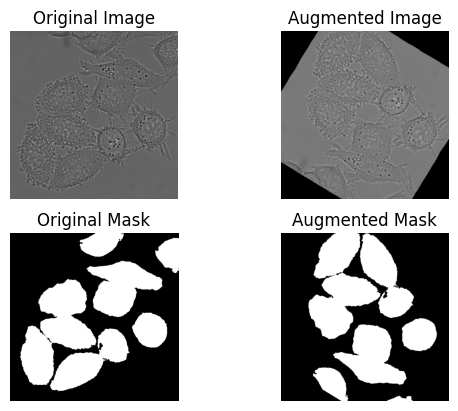

In [12]:
dataset = CellDataset(image_dir=train_path, mask_dir=train_masks[0], transforms=None)
img1, mask1 = dataset[3]
torch.manual_seed(0)
img2, out = transforms(img1, {"masks": mask1})
mask2 = out["masks"]

plt.subplot(2,2,1); plt.imshow(img1.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Original Image");
plt.subplot(2,2,2); plt.imshow(img2.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Augmented Image");
plt.subplot(2,2,3); plt.imshow(mask1.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Original Mask");
plt.subplot(2,2,4); plt.imshow(mask2.squeeze(), cmap='gray'); plt.axis("off"); plt.title("Augmented Mask");
plt.show()

In [13]:
import torch.nn as nn
import torch.functional as F
from torchvision.models import resnet34, ResNet34_Weights
from torchsummary import summary

In [14]:
net = resnet34(weights=ResNet34_Weights.IMAGENET1K_V1)

Downloading: "https://download.pytorch.org/models/resnet34-b627a593.pth" to /root/.cache/torch/hub/checkpoints/resnet34-b627a593.pth


100%|██████████| 83.3M/83.3M [00:00<00:00, 104MB/s]


In [15]:
weights = net.conv1.weight.data.mean(dim=1).unsqueeze(dim=1)
conv_gray = nn.Conv2d(in_channels=1, out_channels=64, kernel_size=7, stride=2, padding=3, bias=False)
conv_gray.weight.data = weights

net.conv1 = conv_gray
net.conv1

Conv2d(1, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)

In [16]:
class UpBlock(nn.Module):
    def __init__(self, in_ch, skip_ch, out_ch):
        super().__init__()
        self.up = nn.ConvTranspose2d(in_ch, out_ch, 2, stride=2)
        self.conv = nn.Sequential(
            nn.Conv2d(out_ch + skip_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(out_ch, out_ch, 3, padding=1),
            nn.ReLU(inplace=True)
        )

    def forward(self, x, skip):
        x = self.up(x)
        x = torch.cat([x, skip], dim=1)
        return self.conv(x)

In [17]:

class SelfAttention(nn.Module):
    def __init__(self, in_ch):
        super().__init__()

        self.query = nn.Conv2d(in_ch, in_ch // 8, 1)
        self.key = nn.Conv2d(in_ch, in_ch // 8, 1)
        self.value = nn.Conv2d(in_ch, in_ch, 1)

        self.gamma = nn.Parameter(torch.zeros(1))

    def forward(self, x):
        B, C, H, W = x.shape

        Q = self.query(x).view(B, -1, H*W)
        K = self.key(x).view(B, -1, H*W)
        V = self.value(x).view(B, C, H*W)

        attn = torch.softmax(torch.bmm(Q.transpose(1,2), K), dim=-1)
        out = torch.matmul(V, attn.transpose(1,2))
        out = out.view(B,C, H, W)
        return self.gamma * out + x


In [18]:
class Encoder(nn.Module):
    def __init__(self, in_ch=1):
        super().__init__()

        backbone = resnet34(weights=ResNet34_Weights.IMAGENET1K_V1)

        # Convert conv1 to grayscale
        weight = backbone.conv1.weight.data.mean(dim=1, keepdim=True)
        conv_gray = nn.Conv2d(in_ch, 64, kernel_size=7, stride=2, padding=3, bias=False)
        conv_gray.weight.data = weight

        backbone.conv1 = conv_gray

        # Encoder layers
        self.layer0 = nn.Sequential(backbone.conv1, backbone.bn1, backbone.relu)
        self.maxpool = backbone.maxpool
        self.layer1  = backbone.layer1
        self.layer2  = backbone.layer2
        self.layer3  = backbone.layer3
        self.layer4  = backbone.layer4

    def forward(self, x):
        x0 = self.layer0(x)
        x1 = self.layer1(self.maxpool(x0))
        x2 = self.layer2(x1)
        x3 = self.layer3(x2)
        x4 = self.layer4(x3)
        return x0, x1, x2, x3, x4



In [19]:
class Decoder(nn.Module):
    def __init__(self):
        super().__init__()
        self.self_attention = SelfAttention(512)

        self.up4 = UpBlock(512, 256, 256)
        self.up3 = UpBlock(256, 128, 128)
        self.up2 = UpBlock(128, 64, 64)
        self.up1 = UpBlock(64, 64, 64)

        self.final = nn.Conv2d(64, 1, kernel_size=1)

    def forward(self, x0, x1, x2, x3, x4, orig_size):
        x4 = self.self_attention(x4)

        d4 = self.up4(x4, x3)
        d3 = self.up3(d4, x2)
        d2 = self.up2(d3, x1)
        d1 = self.up1(d2, x0)

        out = nn.functional.interpolate(d1, size=orig_size, mode='bilinear')
        return self.final(out)



In [20]:
class UNet(nn.Module):
    def __init__(self, in_ch=1, num_classes=1):
        super().__init__()
        self.encoder = Encoder(in_ch=in_ch)
        self.decoder = Decoder()
        self.num_classes = num_classes

    def freeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = False

    def unfreeze_encoder(self):
        for param in self.encoder.parameters():
            param.requires_grad = True

    def forward(self, x):
        orig_size = x.shape[2:]
        x0, x1, x2, x3, x4 = self.encoder(x)
        return self.decoder(x0, x1, x2, x3, x4, orig_size)

In [21]:
model = UNet(in_ch=1, num_classes=1)

In [ ]:
model.to(device);
model.freeze_encoder()
summary(model, (1,512,512))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 256, 256]           3,136
       BatchNorm2d-2         [-1, 64, 256, 256]             128
              ReLU-3         [-1, 64, 256, 256]               0
         MaxPool2d-4         [-1, 64, 128, 128]               0
            Conv2d-5         [-1, 64, 128, 128]          36,864
       BatchNorm2d-6         [-1, 64, 128, 128]             128
              ReLU-7         [-1, 64, 128, 128]               0
            Conv2d-8         [-1, 64, 128, 128]          36,864
       BatchNorm2d-9         [-1, 64, 128, 128]             128
             ReLU-10         [-1, 64, 128, 128]               0
       BasicBlock-11         [-1, 64, 128, 128]               0
           Conv2d-12         [-1, 64, 128, 128]          36,864
      BatchNorm2d-13         [-1, 64, 128, 128]             128
             ReLU-14         [-1, 64, 1

In [22]:
def checkpoint(model, filename):
    torch.save(model.state_dict(), filename)

def resume(model, path, device="cpu"):
    ckpt = torch.load(path, map_location=device)

    if "model_state_dict" in ckpt:
        model.load_state_dict(ckpt["model_state_dict"])
    elif "model" in ckpt:
        model.load_state_dict(ckpt["model"])
    else:
        model.load_state_dict(ckpt)

    print("Checkpoint loaded successfully.")
    return model


In [ ]:
from tqdm.auto import tqdm

In [ ]:
def train(model, epoch, train, dataloader, optimizer, device, BCE, dice_score=soft_dice, iou_score=soft_iou):

    model.train()

    total_loss = 0.0
    total_dice = 0.0
    total_iou = 0.0
    batch_count = 0

    for Image, Mask in tqdm(dataloader):
        X = Image.to(device)
        y = Mask.to(device).float()

        optimizer.zero_grad()

        logits = model(X)

        if train == "Finetune":
            loss = BCE(logits, y) + (1 - dice_score(logits, y))
        else:
            loss = combined_loss(logits=logits, targets=y, bce_loss=BCE, alpha=0.3)

        loss.backward()
        optimizer.step()

        total_loss += loss.item()


        with torch.no_grad():
            dice_val = dice_score(logits.detach(), y).item()
            iou_val  = iou_score(logits.detach(), y).item()

            total_dice += dice_val
            total_iou  += iou_val

            batch_count += 1


    avg_loss = total_loss / batch_count
    avg_dice = total_dice / batch_count
    avg_iou  = total_iou  / batch_count

    print(f"{train} Epoch {epoch} | "
          f"Loss: {avg_loss:.4f} | Dice: {avg_dice:.4f} | IoU: {avg_iou:.4f}")

    return avg_loss, avg_dice, avg_iou


In [ ]:
def test(
    model,
    dataloader,
    device,
    BCE,
    epoch,
    dice_score=hard_dice,
    iou_score=hard_iou,
    mode="Test"
):
    model.eval()

    total_loss = 0.0
    total_dice = 0.0
    total_iou = 0.0
    batch_count = 0

    with torch.inference_mode():
        for images, masks in tqdm(dataloader):
            images = images.to(device)
            masks = masks.to(device).float()

            logits = model(images)


            dice_val = dice_score(logits, masks)
            loss = BCE(logits, masks) + (1 - dice_val)


            total_loss += loss.item()
            total_dice += dice_val.item()
            total_iou  += iou_score(logits, masks).item()

            batch_count += 1


    avg_loss = total_loss / batch_count
    avg_dice = total_dice / batch_count
    avg_iou  = total_iou  / batch_count

    print(
        f"{mode} Epoch: {epoch} | "
        f"Loss: {avg_loss:.4f} | Dice: {avg_dice:.4f} | IoU: {avg_iou:.4f}"
    )

    return avg_loss, avg_dice, avg_iou


In [ ]:
pretrain_train_losses = []
pretrain_dice_scores = []
pretrain_iou_scores = []

pretrain_val_train_losses = []
pretrain_val_dice_scores = []
pretrain_val_iou_scores = []

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4)
loss_fn = nn.BCEWithLogitsLoss()
epochs = 50

early_stopping_thresh = 10
best_score = -1
best_epoch = -1

for epoch in range(epochs):
    tr_loss, tr_dice_score, tr_iou_score = train(model=model, epoch=epoch+1, train="Pre-Train", dataloader=pretrain_loader, optimizer=optimizer, device=device, BCE=loss_fn)
    val_loss, val_dice_score, val_iou_score = test(model=model, epoch=epoch+1, dataloader=val_loader, device=device, BCE=loss_fn, mode="Val")
    print("*"*20)
    pretrain_train_losses.append(tr_loss)
    pretrain_dice_scores.append(tr_dice_score)
    pretrain_iou_scores.append(tr_iou_score)

    pretrain_val_train_losses.append(val_loss)
    pretrain_val_dice_scores.append(val_dice_score)
    pretrain_val_iou_scores.append(val_iou_score)

    if ((val_dice_score + val_iou_score) / 2) > best_score:
        best_score = (val_dice_score + val_iou_score) / 2
        best_epoch = epoch
        checkpoint(model, f"drive/MyDrive/models/pretrain_best_model.pth")
        print(f"Model Checkpointed at Best Epoch: {epoch+1}")
    elif epoch - best_epoch > early_stopping_thresh:
        print(f"Early Stopped Training at Epoch: {epoch+1}")
        break

print(f"Pre-training best model from epoch: {best_epoch}, Best Score: {best_score}")

  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 1 | Loss: 0.4526 | Dice: 0.6222 | IoU: 0.4616


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 1 | Loss: 0.7155 | Dice: 0.7820 | IoU: 0.6458
********************
Model Checkpointed at Best Epoch: 1


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 2 | Loss: 0.2420 | Dice: 0.8163 | IoU: 0.6912


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 2 | Loss: 0.5540 | Dice: 0.8358 | IoU: 0.7191
********************
Model Checkpointed at Best Epoch: 2


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 3 | Loss: 0.1865 | Dice: 0.8585 | IoU: 0.7526


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 3 | Loss: 0.4936 | Dice: 0.8621 | IoU: 0.7582
********************
Model Checkpointed at Best Epoch: 3


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 4 | Loss: 0.1661 | Dice: 0.8741 | IoU: 0.7767


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 4 | Loss: 0.6305 | Dice: 0.8339 | IoU: 0.7159
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 5 | Loss: 0.1588 | Dice: 0.8791 | IoU: 0.7847


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 5 | Loss: 0.4166 | Dice: 0.8915 | IoU: 0.8045
********************
Model Checkpointed at Best Epoch: 5


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 6 | Loss: 0.1547 | Dice: 0.8833 | IoU: 0.7916


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 6 | Loss: 0.4356 | Dice: 0.8793 | IoU: 0.7850
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 7 | Loss: 0.1392 | Dice: 0.8941 | IoU: 0.8088


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 7 | Loss: 0.3973 | Dice: 0.8990 | IoU: 0.8168
********************
Model Checkpointed at Best Epoch: 7


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 8 | Loss: 0.1340 | Dice: 0.8991 | IoU: 0.8170


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 8 | Loss: 0.3480 | Dice: 0.9109 | IoU: 0.8367
********************
Model Checkpointed at Best Epoch: 8


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 9 | Loss: 0.1312 | Dice: 0.9008 | IoU: 0.8199


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 9 | Loss: 0.4223 | Dice: 0.9017 | IoU: 0.8212
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 10 | Loss: 0.1277 | Dice: 0.9046 | IoU: 0.8262


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 10 | Loss: 0.3554 | Dice: 0.9119 | IoU: 0.8383
********************
Model Checkpointed at Best Epoch: 10


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 11 | Loss: 0.1179 | Dice: 0.9112 | IoU: 0.8372


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 11 | Loss: 0.4340 | Dice: 0.8939 | IoU: 0.8086
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 12 | Loss: 0.1160 | Dice: 0.9134 | IoU: 0.8409


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 12 | Loss: 0.3249 | Dice: 0.9192 | IoU: 0.8507
********************
Model Checkpointed at Best Epoch: 12


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 13 | Loss: 0.1160 | Dice: 0.9133 | IoU: 0.8408


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 13 | Loss: 0.3387 | Dice: 0.9134 | IoU: 0.8408
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 14 | Loss: 0.1112 | Dice: 0.9170 | IoU: 0.8469


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 14 | Loss: 0.3113 | Dice: 0.9211 | IoU: 0.8540
********************
Model Checkpointed at Best Epoch: 14


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 15 | Loss: 0.1165 | Dice: 0.9128 | IoU: 0.8401


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 15 | Loss: 0.3342 | Dice: 0.9211 | IoU: 0.8541
********************
Model Checkpointed at Best Epoch: 15


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 16 | Loss: 0.1057 | Dice: 0.9217 | IoU: 0.8551


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 16 | Loss: 0.3835 | Dice: 0.9074 | IoU: 0.8309
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 17 | Loss: 0.1051 | Dice: 0.9215 | IoU: 0.8548


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 17 | Loss: 0.3035 | Dice: 0.9268 | IoU: 0.8638
********************
Model Checkpointed at Best Epoch: 17


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 18 | Loss: 0.1034 | Dice: 0.9232 | IoU: 0.8577


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 18 | Loss: 0.3086 | Dice: 0.9259 | IoU: 0.8624
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 19 | Loss: 0.1005 | Dice: 0.9255 | IoU: 0.8616


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 19 | Loss: 0.3031 | Dice: 0.9252 | IoU: 0.8612
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 20 | Loss: 0.1000 | Dice: 0.9257 | IoU: 0.8620


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 20 | Loss: 0.3608 | Dice: 0.9112 | IoU: 0.8372
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 21 | Loss: 0.0971 | Dice: 0.9273 | IoU: 0.8648


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 21 | Loss: 0.2872 | Dice: 0.9296 | IoU: 0.8687
********************
Model Checkpointed at Best Epoch: 21


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 22 | Loss: 0.0980 | Dice: 0.9272 | IoU: 0.8647


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 22 | Loss: 0.2763 | Dice: 0.9326 | IoU: 0.8740
********************
Model Checkpointed at Best Epoch: 22


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 23 | Loss: 0.0962 | Dice: 0.9281 | IoU: 0.8661


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 23 | Loss: 0.3023 | Dice: 0.9281 | IoU: 0.8661
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 24 | Loss: 0.0967 | Dice: 0.9282 | IoU: 0.8663


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 24 | Loss: 0.4154 | Dice: 0.9044 | IoU: 0.8259
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 25 | Loss: 0.0961 | Dice: 0.9285 | IoU: 0.8669


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 25 | Loss: 0.3142 | Dice: 0.9261 | IoU: 0.8627
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 26 | Loss: 0.0943 | Dice: 0.9300 | IoU: 0.8694


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 26 | Loss: 0.3260 | Dice: 0.9143 | IoU: 0.8425
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 27 | Loss: 0.0938 | Dice: 0.9304 | IoU: 0.8701


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 27 | Loss: 0.2812 | Dice: 0.9349 | IoU: 0.8782
********************
Model Checkpointed at Best Epoch: 27


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 28 | Loss: 0.0943 | Dice: 0.9295 | IoU: 0.8686


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 28 | Loss: 0.3598 | Dice: 0.9162 | IoU: 0.8457
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 29 | Loss: 0.0938 | Dice: 0.9301 | IoU: 0.8697


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 29 | Loss: 0.2948 | Dice: 0.9279 | IoU: 0.8658
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 30 | Loss: 0.0901 | Dice: 0.9329 | IoU: 0.8746


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 30 | Loss: 0.3306 | Dice: 0.9191 | IoU: 0.8507
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 31 | Loss: 0.0916 | Dice: 0.9318 | IoU: 0.8726


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 31 | Loss: 0.2847 | Dice: 0.9304 | IoU: 0.8702
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 32 | Loss: 0.0926 | Dice: 0.9312 | IoU: 0.8715


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 32 | Loss: 0.2923 | Dice: 0.9339 | IoU: 0.8763
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 33 | Loss: 0.0887 | Dice: 0.9339 | IoU: 0.8763


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 33 | Loss: 0.2975 | Dice: 0.9324 | IoU: 0.8736
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 34 | Loss: 0.0907 | Dice: 0.9326 | IoU: 0.8740


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 34 | Loss: 0.2919 | Dice: 0.9287 | IoU: 0.8673
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 35 | Loss: 0.0885 | Dice: 0.9342 | IoU: 0.8769


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 35 | Loss: 0.2788 | Dice: 0.9308 | IoU: 0.8708
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 36 | Loss: 0.0892 | Dice: 0.9339 | IoU: 0.8762


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 36 | Loss: 0.2683 | Dice: 0.9337 | IoU: 0.8760
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 37 | Loss: 0.0881 | Dice: 0.9343 | IoU: 0.8769


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 37 | Loss: 0.2761 | Dice: 0.9354 | IoU: 0.8789
********************
Model Checkpointed at Best Epoch: 37


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 38 | Loss: 0.0873 | Dice: 0.9351 | IoU: 0.8784


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 38 | Loss: 0.2699 | Dice: 0.9317 | IoU: 0.8724
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 39 | Loss: 0.0855 | Dice: 0.9364 | IoU: 0.8808


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 39 | Loss: 0.3513 | Dice: 0.9235 | IoU: 0.8583
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 40 | Loss: 0.0878 | Dice: 0.9347 | IoU: 0.8776


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 40 | Loss: 0.3092 | Dice: 0.9294 | IoU: 0.8684
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 41 | Loss: 0.0881 | Dice: 0.9347 | IoU: 0.8778


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 41 | Loss: 0.2589 | Dice: 0.9380 | IoU: 0.8836
********************
Model Checkpointed at Best Epoch: 41


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 42 | Loss: 0.0860 | Dice: 0.9362 | IoU: 0.8804


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 42 | Loss: 0.3399 | Dice: 0.9154 | IoU: 0.8443
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 43 | Loss: 0.0833 | Dice: 0.9378 | IoU: 0.8832


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 43 | Loss: 0.3168 | Dice: 0.9261 | IoU: 0.8628
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 44 | Loss: 0.0899 | Dice: 0.9335 | IoU: 0.8756


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 44 | Loss: 0.2868 | Dice: 0.9332 | IoU: 0.8751
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 45 | Loss: 0.0855 | Dice: 0.9366 | IoU: 0.8810


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 45 | Loss: 0.2988 | Dice: 0.9271 | IoU: 0.8645
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 46 | Loss: 0.0833 | Dice: 0.9379 | IoU: 0.8833


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 46 | Loss: 0.3248 | Dice: 0.9219 | IoU: 0.8555
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 47 | Loss: 0.0829 | Dice: 0.9385 | IoU: 0.8843


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 47 | Loss: 0.2937 | Dice: 0.9286 | IoU: 0.8671
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 48 | Loss: 0.0846 | Dice: 0.9368 | IoU: 0.8815


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 48 | Loss: 0.2638 | Dice: 0.9342 | IoU: 0.8769
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 49 | Loss: 0.0834 | Dice: 0.9382 | IoU: 0.8839


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 49 | Loss: 0.2785 | Dice: 0.9317 | IoU: 0.8725
********************


  0%|          | 0/84 [00:00<?, ?it/s]

Pre-Train Epoch 50 | Loss: 0.0823 | Dice: 0.9387 | IoU: 0.8847


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 50 | Loss: 0.4008 | Dice: 0.9123 | IoU: 0.8391
********************
Pre-training best model from epoch: 40, Best Score: 0.9107856431177683


In [ ]:
model = UNet(in_ch=1, num_classes=1)
model = resume(model=model, path="drive/MyDrive/models/pretrain_best_model.pth", device=device)
print(f"Loaded Model from Epoch: {best_epoch}")

Checkpoint loaded successfully.
Loaded Model from Epoch: 40


In [ ]:
model.unfreeze_encoder()
model.to(device);
encoder = []
decoder = []

for param in model.encoder.parameters():
    encoder.append(param)

for param in model.decoder.parameters():
    decoder.append(param)

optimizer = torch.optim.Adam([
    {"params": encoder, "lr": 1e-5},
    {"params": decoder, "lr": 1e-4}
])

In [ ]:
finetune_train_losses = []
finetune_dice_scores = []
finetune_iou_scores = []

finetune_val_train_losses = []
finetune_val_dice_scores = []
finetune_val_iou_scores = []

loss_fn = nn.BCEWithLogitsLoss()
epochs = 50

early_stopping_thresh = 10
best_score = -1
best_epoch = -1

# Explicitly ensure the problematic conv_gray layer is on the correct device
# This addresses the RuntimeError: Input type (torch.cuda.FloatTensor) and weight type (torch.FloatTensor) should be the same
# which likely occurs due to the direct assignment to .weight.data in the Encoder's __init__.
if hasattr(model.encoder, 'layer0') and isinstance(model.encoder.layer0, nn.Sequential) and len(model.encoder.layer0) > 0:
    if hasattr(model.encoder.layer0[0], 'weight'):
        model.encoder.layer0[0].to(device)

for epoch in range(epochs):
    tr_loss, tr_dice_score, tr_iou_score = train(model=model, epoch=epoch+1, train="Finetune", dataloader=finetune_loader, optimizer=optimizer, device=device, BCE=loss_fn)
    val_loss, val_dice_score, val_iou_score = test(model=model, epoch=epoch+1, dataloader=val_loader, device=device, BCE=loss_fn, mode="Val")
    print("*"*20)
    finetune_train_losses.append(tr_loss)
    finetune_dice_scores.append(tr_dice_score)
    finetune_iou_scores.append(tr_iou_score)

    finetune_val_train_losses.append(val_loss)
    finetune_val_dice_scores.append(val_dice_score)
    finetune_val_iou_scores.append(val_iou_score)

    if ((val_dice_score + val_iou_score) / 2) > best_score:
        best_score = tr_dice_score
        best_epoch = epoch
        checkpoint(model, f"drive/MyDrive/models/finetune_best_model.pth")
        print(f"Model Checkpointed at Best Epoch: {epoch+1}")
    elif epoch - best_epoch > early_stopping_thresh:
        print(f"Early Stopped Training at Epoch: {epoch+1}")
        break

print(f"Finetuning best model from epoch: {best_epoch+1}, Best Score: {best_score}")

  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 1 | Loss: 0.6463 | Dice: 0.8142 | IoU: 0.7229


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 1 | Loss: 0.2623 | Dice: 0.9277 | IoU: 0.8655
********************
Model Checkpointed at Best Epoch: 1


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 2 | Loss: 0.5094 | Dice: 0.8300 | IoU: 0.7492


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 2 | Loss: 0.2644 | Dice: 0.9279 | IoU: 0.8659
********************
Model Checkpointed at Best Epoch: 2


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 3 | Loss: 0.4276 | Dice: 0.8299 | IoU: 0.7466


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 3 | Loss: 0.5057 | Dice: 0.8708 | IoU: 0.7726
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 4 | Loss: 0.4777 | Dice: 0.8214 | IoU: 0.7314


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 4 | Loss: 0.3195 | Dice: 0.9141 | IoU: 0.8423
********************
Model Checkpointed at Best Epoch: 4


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 5 | Loss: 0.4485 | Dice: 0.8226 | IoU: 0.7341


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 5 | Loss: 0.4270 | Dice: 0.8816 | IoU: 0.7896
********************
Model Checkpointed at Best Epoch: 5


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 6 | Loss: 0.4262 | Dice: 0.8125 | IoU: 0.7163


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 6 | Loss: 0.3151 | Dice: 0.9146 | IoU: 0.8433
********************
Model Checkpointed at Best Epoch: 6


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 7 | Loss: 0.4167 | Dice: 0.8360 | IoU: 0.7561


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 7 | Loss: 0.4503 | Dice: 0.8921 | IoU: 0.8063
********************
Model Checkpointed at Best Epoch: 7


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 8 | Loss: 0.4181 | Dice: 0.8383 | IoU: 0.7587


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 8 | Loss: 0.4014 | Dice: 0.8989 | IoU: 0.8172
********************
Model Checkpointed at Best Epoch: 8


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 9 | Loss: 0.4596 | Dice: 0.8117 | IoU: 0.7136


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 9 | Loss: 0.3594 | Dice: 0.9038 | IoU: 0.8253
********************
Model Checkpointed at Best Epoch: 9


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 10 | Loss: 0.4053 | Dice: 0.8325 | IoU: 0.7482


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 10 | Loss: 0.3206 | Dice: 0.9137 | IoU: 0.8417
********************
Model Checkpointed at Best Epoch: 10


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 11 | Loss: 0.3992 | Dice: 0.8367 | IoU: 0.7546


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 11 | Loss: 0.5810 | Dice: 0.8637 | IoU: 0.7621
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 12 | Loss: 0.3900 | Dice: 0.8361 | IoU: 0.7479


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 12 | Loss: 0.5369 | Dice: 0.8743 | IoU: 0.7786
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 13 | Loss: 0.3817 | Dice: 0.8394 | IoU: 0.7546


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 13 | Loss: 0.3802 | Dice: 0.9015 | IoU: 0.8217
********************
Model Checkpointed at Best Epoch: 13


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 14 | Loss: 0.4078 | Dice: 0.8370 | IoU: 0.7540


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 14 | Loss: 0.3408 | Dice: 0.9092 | IoU: 0.8342
********************
Model Checkpointed at Best Epoch: 14


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 15 | Loss: 0.3601 | Dice: 0.8427 | IoU: 0.7596


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 15 | Loss: 0.4679 | Dice: 0.8833 | IoU: 0.7924
********************
Model Checkpointed at Best Epoch: 15


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 16 | Loss: 0.3220 | Dice: 0.8616 | IoU: 0.7826


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 16 | Loss: 0.5718 | Dice: 0.8718 | IoU: 0.7747
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 17 | Loss: 0.3802 | Dice: 0.8503 | IoU: 0.7726


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 17 | Loss: 0.5002 | Dice: 0.8863 | IoU: 0.7975
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 18 | Loss: 0.4170 | Dice: 0.8258 | IoU: 0.7287


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 18 | Loss: 0.4462 | Dice: 0.8824 | IoU: 0.7914
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 19 | Loss: 0.3447 | Dice: 0.8454 | IoU: 0.7613


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 19 | Loss: 0.3827 | Dice: 0.8974 | IoU: 0.8149
********************
Model Checkpointed at Best Epoch: 19


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 20 | Loss: 0.3704 | Dice: 0.8499 | IoU: 0.7719


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 20 | Loss: 0.4637 | Dice: 0.8841 | IoU: 0.7936
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 21 | Loss: 0.3581 | Dice: 0.8508 | IoU: 0.7704


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 21 | Loss: 0.4303 | Dice: 0.8881 | IoU: 0.8002
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 22 | Loss: 0.3448 | Dice: 0.8479 | IoU: 0.7560


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 22 | Loss: 0.5566 | Dice: 0.8550 | IoU: 0.7494
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 23 | Loss: 0.3598 | Dice: 0.8468 | IoU: 0.7578


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 23 | Loss: 0.3260 | Dice: 0.9133 | IoU: 0.8414
********************
Model Checkpointed at Best Epoch: 23


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 24 | Loss: 0.3077 | Dice: 0.8603 | IoU: 0.7737


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 24 | Loss: 0.7179 | Dice: 0.8304 | IoU: 0.7138
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 25 | Loss: 0.3321 | Dice: 0.8557 | IoU: 0.7707


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 25 | Loss: 0.4033 | Dice: 0.8931 | IoU: 0.8084
********************
Model Checkpointed at Best Epoch: 25


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 26 | Loss: 0.2304 | Dice: 0.8980 | IoU: 0.8214


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 26 | Loss: 0.6445 | Dice: 0.8433 | IoU: 0.7320
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 27 | Loss: 0.2383 | Dice: 0.8992 | IoU: 0.8218


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 27 | Loss: 0.5103 | Dice: 0.8842 | IoU: 0.7940
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 28 | Loss: 0.3165 | Dice: 0.8688 | IoU: 0.7901


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 28 | Loss: 0.6176 | Dice: 0.8489 | IoU: 0.7401
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 29 | Loss: 0.3157 | Dice: 0.8638 | IoU: 0.7714


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 29 | Loss: 0.3267 | Dice: 0.9086 | IoU: 0.8335
********************
Model Checkpointed at Best Epoch: 29


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 30 | Loss: 0.2943 | Dice: 0.8661 | IoU: 0.7824


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 30 | Loss: 0.4200 | Dice: 0.8868 | IoU: 0.7983
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 31 | Loss: 0.3118 | Dice: 0.8667 | IoU: 0.7873


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 31 | Loss: 0.4781 | Dice: 0.8753 | IoU: 0.7799
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 32 | Loss: 0.3129 | Dice: 0.8685 | IoU: 0.7755


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 32 | Loss: 0.5787 | Dice: 0.8514 | IoU: 0.7448
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 33 | Loss: 0.2506 | Dice: 0.8906 | IoU: 0.8131


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 33 | Loss: 0.4062 | Dice: 0.8946 | IoU: 0.8112
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 34 | Loss: 0.3073 | Dice: 0.8676 | IoU: 0.7878


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 34 | Loss: 0.7703 | Dice: 0.8122 | IoU: 0.6893
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 35 | Loss: 0.2685 | Dice: 0.8823 | IoU: 0.7986


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 35 | Loss: 0.4391 | Dice: 0.8952 | IoU: 0.8121
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 36 | Loss: 0.2818 | Dice: 0.8803 | IoU: 0.8042


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 36 | Loss: 0.3610 | Dice: 0.9102 | IoU: 0.8361
********************
Model Checkpointed at Best Epoch: 36


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 37 | Loss: 0.3301 | Dice: 0.8598 | IoU: 0.7728


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 37 | Loss: 0.8126 | Dice: 0.8155 | IoU: 0.6940
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 38 | Loss: 0.2337 | Dice: 0.9009 | IoU: 0.8230


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 38 | Loss: 0.5041 | Dice: 0.8718 | IoU: 0.7756
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 39 | Loss: 0.2235 | Dice: 0.9032 | IoU: 0.8279


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 39 | Loss: 0.5336 | Dice: 0.8745 | IoU: 0.7793
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 40 | Loss: 0.2118 | Dice: 0.9087 | IoU: 0.8358


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 40 | Loss: 0.6912 | Dice: 0.8454 | IoU: 0.7350
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 41 | Loss: 0.2074 | Dice: 0.9128 | IoU: 0.8410


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 41 | Loss: 0.4946 | Dice: 0.8883 | IoU: 0.8007
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 42 | Loss: 0.1927 | Dice: 0.9231 | IoU: 0.8580


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 42 | Loss: 0.4584 | Dice: 0.8941 | IoU: 0.8099
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 43 | Loss: 0.2222 | Dice: 0.9101 | IoU: 0.8376


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 43 | Loss: 0.4897 | Dice: 0.8817 | IoU: 0.7901
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 44 | Loss: 0.1878 | Dice: 0.9198 | IoU: 0.8528


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 44 | Loss: 0.3789 | Dice: 0.9054 | IoU: 0.8285
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 45 | Loss: 0.1988 | Dice: 0.9149 | IoU: 0.8455


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 45 | Loss: 0.6272 | Dice: 0.8714 | IoU: 0.7749
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 46 | Loss: 0.1857 | Dice: 0.9230 | IoU: 0.8589


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 46 | Loss: 0.5908 | Dice: 0.8818 | IoU: 0.7908
********************


  0%|          | 0/9 [00:00<?, ?it/s]

Finetune Epoch 47 | Loss: 0.1889 | Dice: 0.9291 | IoU: 0.8677


  0%|          | 0/84 [00:00<?, ?it/s]

Val Epoch: 47 | Loss: 0.5205 | Dice: 0.8885 | IoU: 0.8014
********************
Early Stopped Training at Epoch: 47
Finetuning best model from epoch: 36, Best Score: 0.8802638385030959


In [23]:
model = UNet(in_ch=1, num_classes=1)
resume(model, "drive/MyDrive/models/finetune_best_model.pth", device)
model.to(device);
# print(f"Finetuning best model from epoch: {best_epoch}, Best Score: {best_score}")


Checkpoint loaded successfully.


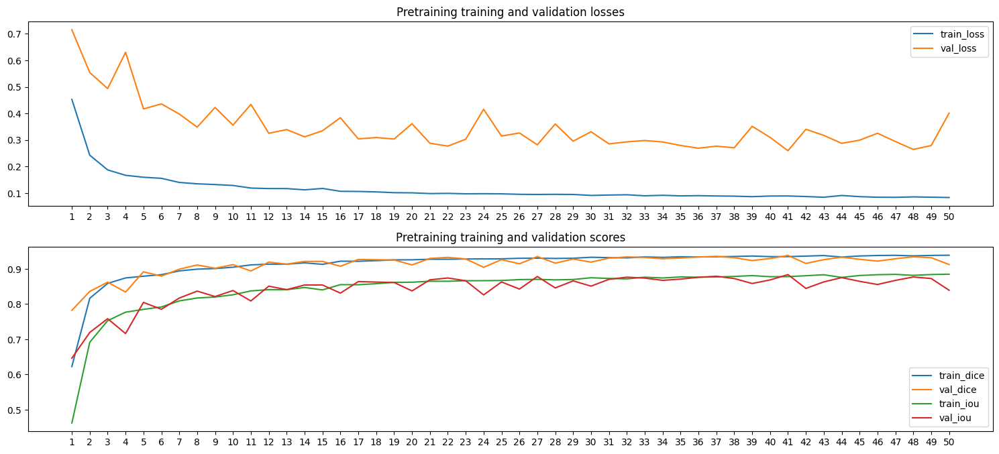

In [ ]:
plt.figure(figsize=(15,10))
plt.subplot(3,1,1); plt.plot(pretrain_train_losses, label="train_loss"); plt.title("Pretraining training and validation losses"); plt.plot(pretrain_val_train_losses, label="val_loss"); plt.legend()
plt.xticks(range(len(pretrain_train_losses)), range(1, len(pretrain_train_losses)+1))

plt.subplot(3,1,2); plt.plot(pretrain_dice_scores, label="train_dice"); plt.title("Pretraining training and validation scores"); plt.plot(pretrain_val_dice_scores, label="val_dice");
plt.plot(pretrain_iou_scores, label="train_iou"); plt.plot(pretrain_val_iou_scores, label="val_iou"); plt.legend()
plt.xticks(range(len(pretrain_val_iou_scores)), range(1, len(pretrain_val_iou_scores)+1))
plt.tight_layout()
plt.show()

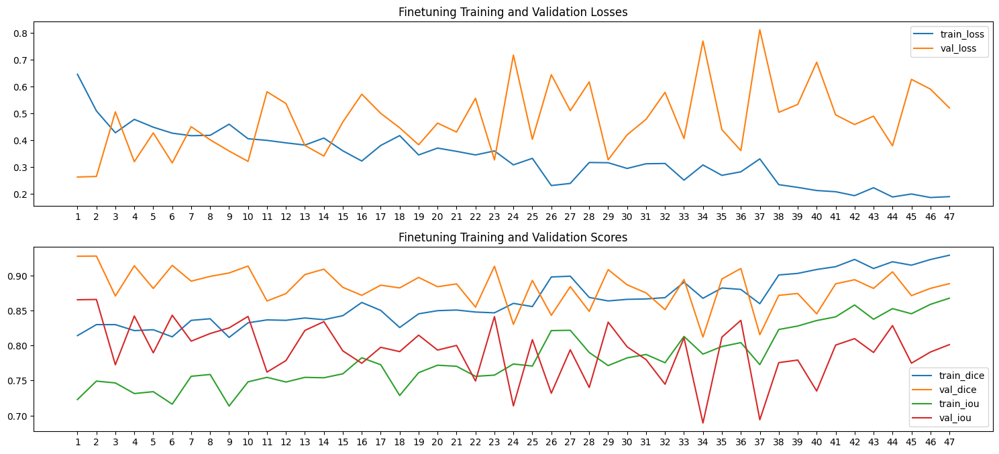

In [ ]:
plt.figure(figsize=(15,10))
plt.subplot(3,1,1); plt.plot(finetune_train_losses, label="train_loss"); plt.title("Finetuning Training and Validation Losses"); plt.plot(finetune_val_train_losses, label="val_loss");
plt.xticks(range(len(finetune_val_train_losses)), range(1, len(finetune_val_train_losses)+1))
plt.legend()

plt.subplot(3,1,2); plt.plot(finetune_dice_scores, label="train_dice"); plt.title("Finetuning Training and Validation Scores"); plt.plot(finetune_val_dice_scores, label="val_dice");
plt.plot(finetune_iou_scores, label="train_iou"); plt.plot(finetune_val_iou_scores, label="val_iou"); plt.legend()
plt.xticks(range(len(finetune_dice_scores)), range(1, len(finetune_dice_scores)+1))
plt.tight_layout()
plt.show()

In [ ]:
loss = nn.BCEWithLogitsLoss()
test_loss, test_dice, test_iou = test(model=model, dataloader=test_loader, epoch=1, device=device, BCE=loss)

  0%|          | 0/9 [00:00<?, ?it/s]

Test Epoch: 1 | Loss: 0.3971 | Dice: 0.8999 | IoU: 0.8187


len(finetune_loader)


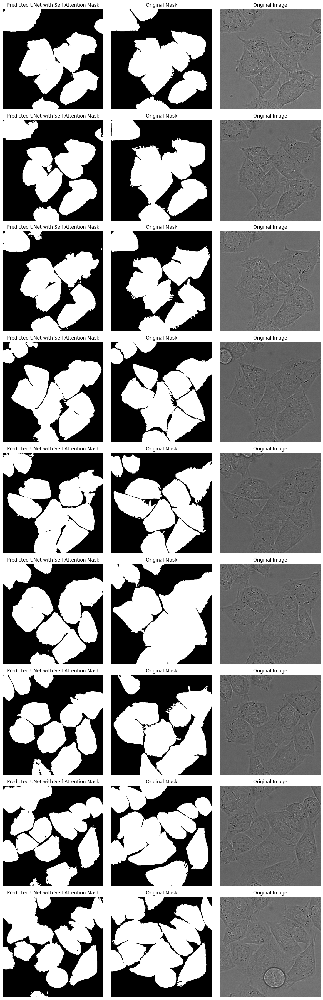

In [ ]:
model.eval()
fig, axes = plt.subplots(nrows=len(test_loader), ncols=3, figsize=(12, 4*len(test_loader)))

with torch.inference_mode():
    for idx, (img, mask) in enumerate(test_loader):
        img_cpu = img.squeeze().cpu().numpy()
        mask_cpu = mask.squeeze().cpu().numpy()
        pred_cpu = (torch.sigmoid(model(img.to(device))).squeeze().cpu().numpy() > 0.5).astype(float)

        # Predicted mask
        axes[idx, 0].imshow(pred_cpu, cmap="gray")
        axes[idx, 0].set_title("Predicted UNet with Self Attention Mask")
        axes[idx, 0].axis("off")

        # Ground truth mask
        axes[idx, 1].imshow(mask_cpu, cmap="gray")
        axes[idx, 1].set_title("Original Mask")
        axes[idx, 1].axis("off")

        # Original image
        axes[idx, 2].imshow(img_cpu, cmap="gray")
        axes[idx, 2].set_title("Original Image")
        axes[idx, 2].axis("off")

plt.tight_layout()
plt.show()


In [ ]:
import pandas as pd

pretrain_metrics = pd.DataFrame({
    "pretrain_train_loss": pretrain_train_losses,
    "pretrain_val_loss": pretrain_val_train_losses,
    "pretrain_train_dice": pretrain_dice_scores,
    "pretrain_val_dice": pretrain_val_dice_scores,
    "pretrain_train_iou": pretrain_iou_scores,
    "pretrain_val_iou": pretrain_val_iou_scores
})

finetune_metrics = pd.DataFrame({
    "finetune_train_loss": finetune_train_losses,
    "finetune_val_loss": finetune_val_train_losses,
    "finetune_train_dice": finetune_dice_scores,
    "finetune_val_dice": finetune_val_dice_scores,
    "finetune_train_iou": finetune_iou_scores,
    "finetune_val_iou": finetune_val_iou_scores
})

pretrain_metrics.to_csv("drive/MyDrive/models/pretrain_metrics.csv", index=False)
finetune_metrics.to_csv("drive/MyDrive/models/finetune_metrics.csv", index=False)

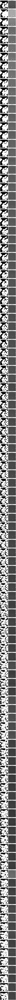

In [151]:
model.eval()
fig, axes = plt.subplots(nrows=len(final_test_loader_02), ncols=2, figsize=(8, 4*len(final_test_loader_02)))
pred_masks = []
test_images = []
with torch.inference_mode():
    for idx, (img) in enumerate(final_test_loader_02):
        img_cpu = img.squeeze().cpu().detach().numpy() * 255
        test_images.append(img_cpu.astype(np.uint8))
        pred_cpu = (torch.sigmoid(model(img.to(device))).squeeze().cpu().detach().numpy() > 0.5).astype(np.float32)
        pred_masks.append((pred_cpu).astype(np.uint8) * 255)
        # Predicted mask
        axes[idx, 0].imshow(pred_cpu, cmap="gray")
        axes[idx, 0].set_title("Predicted Mask - U-Net with Self Attenttion")
        axes[idx, 0].axis("off")

        # Original image
        axes[idx, 1].imshow(img_cpu, cmap="gray")
        axes[idx, 1].set_title("Original Image")
        axes[idx, 1].axis("off")

plt.tight_layout()
plt.show()


In [24]:
import cv2

def get_binary_mask(model, img, device):
    img = test_transform(img)
    with torch.inference_mode():
        mask = torch.sigmoid(model(img.to(device))).squeeze().cpu().detach().numpy() > 0.5
    return mask.astype(np.uint8) * 255

def opening(mask, kernel):
    return cv2.dilate(cv2.erode(mask, kernel), kernel)

def closing(mask, kernel):
    return cv2.erode(cv2.dilate(mask, kernel), kernel)

def get_ith_image_from_dataloader(dataloader, i, device="cpu"):
    batch_size = dataloader.batch_size
    batch_idx = i // batch_size
    idx_in_batch = i % batch_size

    for b, (images) in enumerate(dataloader):
        if b == batch_idx:
            return images[idx_in_batch]


In [29]:
def unsharp(image, k=1.0, sigma=1):
    blur = cv2.GaussianBlur(image.astype(np.float32), (7,7), sigma)

    mask = image - blur

    sharp = image + k * mask

    sharp = np.clip(sharp, 0, 255).astype(np.uint8)

    return sharp

In [30]:
dataloader = get_test_loaders(image_path=test_path[0], batch_size=1, shuffle=False, transforms=None)
image = get_ith_image_from_dataloader(dataloader, 40, device).unsqueeze(dim=0)
image.shape


torch.Size([1, 1, 512, 512])

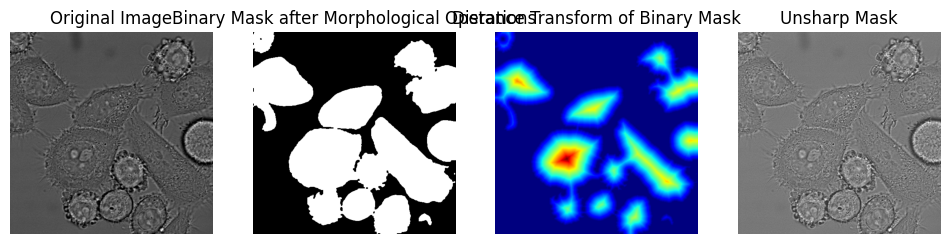

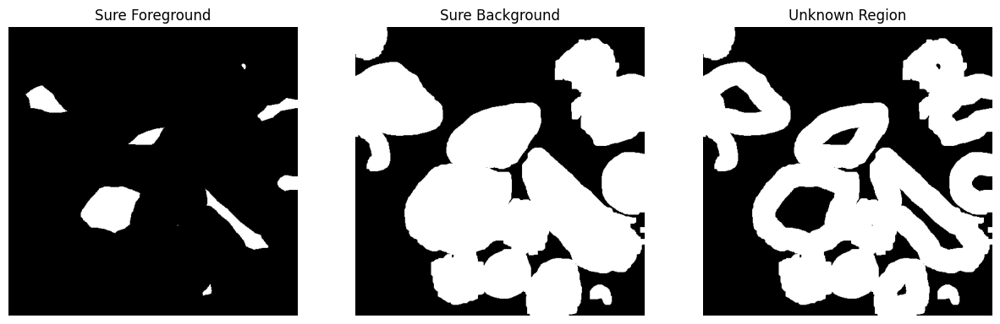

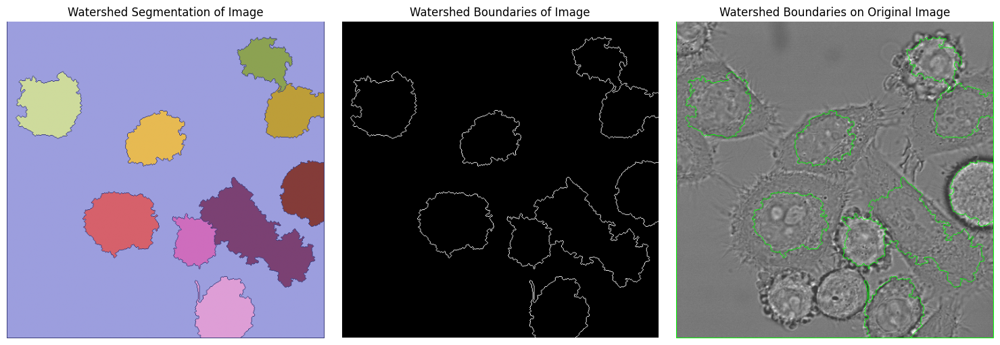

In [33]:
unsharp_flag = True
kernel = np.ones((3,3), np.uint8)

image_cpu = (((image.squeeze().cpu().detach().numpy())) * 255).astype(np.uint8)

mask = get_binary_mask(model=model, device=device, img=image)
mask = opening(mask, kernel)
mask = closing(mask, kernel)
mask = mask.astype(np.uint8) * 255


# Distance map
dist = cv2.distanceTransform(mask, cv2.DIST_L2, 5)



k = 0.5
_, sure_fg = cv2.threshold(dist, k*dist.max(), 255, 0)
sure_fg = np.uint8(sure_fg)
sure_bg = cv2.dilate(mask, kernel, iterations=3)
unknown = cv2.subtract(sure_bg, sure_fg)




_, markers = cv2.connectedComponents(sure_fg)
markers = markers + 1
markers[unknown == 1] = 0


img = np.stack([image_cpu,image_cpu,image_cpu], axis=-1)
rgb = img.copy()
figs = 3
if unsharp_flag:
  rgb = unsharp(rgb)
  figs = 4

markers = cv2.watershed(rgb, markers)

img[markers == -1] = [0,255,0]

plt.figure(figsize=(15,5))
plt.subplot(1,figs,1); plt.imshow(image_cpu, cmap="gray"); plt.axis("off");plt.title("Original Image")
plt.subplot(1,figs,2); plt.imshow(mask, cmap="gray"); plt.axis("off");plt.title("Binary Mask after Morphological Operations")
plt.subplot(1,figs,3);plt.imshow(dist, cmap="jet"); plt.axis("off");plt.title("Distance Transform of Binary Mask")
if unsharp_flag:

  plt.subplot(1,figs,4);plt.imshow(rgb); plt.axis("off");plt.title("Unsharp Mask")
plt.show()

plt.figure(figsize=(15,5))
plt.subplot(1,3,1); plt.imshow(sure_fg, cmap="gray"); plt.axis("off");plt.title("Sure Foreground")
plt.subplot(1,3,2); plt.imshow(sure_bg, cmap="gray"); plt.axis("off");plt.title("Sure Background")
plt.subplot(1,3,3);plt.imshow(unknown, cmap="gray"); plt.axis("off");plt.title("Unknown Region")
plt.show()

plt.figure(figsize=(15,5));plt.subplot(1,3,1);plt.imshow(markers, cmap="tab20b");plt.axis("off");plt.title(f"Watershed Segmentation of Image");
plt.subplot(1,3,2);plt.imshow(markers == -1, cmap="gray");plt.axis("off");plt.title(f"Watershed Boundaries of Image")


plt.subplot(1,3,3);plt.imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB));plt.axis("off");plt.title(f"Watershed Boundaries on Original Image")

plt.tight_layout()
plt.show()


In [47]:
def img_to_video(out_path, vid_name, images, fps=24):
    full_path = out_path + vid_name

    first = images[0].copy()
    first = cv2.cvtColor(first.astype(np.uint8), cv2.COLOR_GRAY2BGR)

    height, width = first.shape[:2]
    video = cv2.VideoWriter(full_path, cv2.VideoWriter_fourcc(*"mp4v"), fps, (width, height))

    for img in images:
        img = cv2.cvtColor(img.astype(np.uint8), cv2.COLOR_GRAY2BGR)

        video.write(img)

    video.release()


In [102]:
img_to_video("./drive/MyDrive/videos/", "pred_masks.mp4", pred_masks)
img_to_video("./drive/MyDrive/videos/", "test_images.mp4", test_images)
